In [111]:
import pandas as pd
import numpy as np
import datetime
from datetime import timedelta
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib
plt.style.use('fivethirtyeight')

%matplotlib inline
%config InlineBackend.figure_format = 'retina'


# Data Preparation and EDA #

## Importing The Cleaned Data ##

In [82]:
# 2015 data for 'prioryear' callout counts from grouped data - to be used for regression.
LFB2015 = pd.read_csv('Assets/LFB2015.csv',index_col=0)
LFB2015.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 98353 entries, 0 to 98352
Data columns (total 11 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   DateOfCall             98353 non-null  object
 1   CalYear                98353 non-null  int64 
 2   HourOfCall             98353 non-null  int64 
 3   IncidentGroup          98353 non-null  object
 4   PropertyType           98353 non-null  object
 5   SpecialServiceType     98353 non-null  object
 6   IncidentStationGround  98353 non-null  object
 7   ob_time                98353 non-null  object
 8   holiday                98353 non-null  int64 
 9   weekend                98353 non-null  int64 
 10  lockdown               98353 non-null  int64 
dtypes: int64(5), object(6)
memory usage: 9.0+ MB


In [83]:
grouped2015 = LFB2015.groupby(['DateOfCall','HourOfCall'], as_index = False).agg({'IncidentGroup':'count',
                               'ob_time':'max'})

grouped2015

,DateOfCall,HourOfCall,IncidentGroup,ob_time
0,01-Apr-15,0,5,2015-04-01 00:00:00
1,01-Apr-15,1,6,2015-04-01 01:00:00
2,01-Apr-15,3,1,2015-04-01 03:00:00
3,01-Apr-15,4,2,2015-04-01 04:00:00
4,01-Apr-15,5,1,2015-04-01 05:00:00
...,...,...,...,...
8725,31-Oct-15,19,31,2015-10-31 19:00:00
8726,31-Oct-15,20,15,2015-10-31 20:00:00
8727,31-Oct-15,21,25,2015-10-31 21:00:00
8728,31-Oct-15,22,25,2015-10-31 22:00:00


In [112]:
# Main data
LFB = pd.read_csv('Assets/LFBwkg.csv', index_col=0)
LFB.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 518227 entries, 0 to 518226
Data columns (total 22 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   DateOfCall             518227 non-null  object 
 1   CalYear                518227 non-null  int64  
 2   HourOfCall             518227 non-null  int64  
 3   IncidentGroup          518227 non-null  object 
 4   PropertyType           518227 non-null  object 
 5   SpecialServiceType     518227 non-null  object 
 6   IncidentStationGround  518227 non-null  object 
 7   ob_time                518227 non-null  object 
 8   holiday                518227 non-null  int64  
 9   weekend                518227 non-null  int64  
 10  lockdown               518227 non-null  int64  
 11  air_temperature        518227 non-null  float64
 12  cld_ttl_amt_id         518227 non-null  float64
 13  islight                518227 non-null  int64  
 14  max_gust_speed         518227 non-nu

In [113]:
# Temp feature engineered to help predict cold weather influence (see 2018 early year spike below)
LFB['tempsq'] = (LFB['air_temperature']-13)**2

In [114]:
# Categorising wind direction, rather than continuos variable.
LFB['wind_dirc'] = pd.cut(LFB['wind_direction'], 
                          bins = [0,20,40,60,80,100,120,140,160,180,200,220,240,260,280,300,320,340,360],
                          labels = ['1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18'])
LFB['wind_dirc'].value_counts()

13    58383
11    58276
12    46525
14    41242
10    35064
9     29172
15    28979
2     28655
3     24508
16    24002
1     22197
4     20752
5     20258
8     19324
17    17544
18    15552
7     15002
6     11962
Name: wind_dirc, dtype: int64

In [115]:
LFB = LFB.drop(columns = ['wind_direction'])

In [116]:
LFB.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 518227 entries, 0 to 518226
Data columns (total 23 columns):
 #   Column                 Non-Null Count   Dtype   
---  ------                 --------------   -----   
 0   DateOfCall             518227 non-null  object  
 1   CalYear                518227 non-null  int64   
 2   HourOfCall             518227 non-null  int64   
 3   IncidentGroup          518227 non-null  object  
 4   PropertyType           518227 non-null  object  
 5   SpecialServiceType     518227 non-null  object  
 6   IncidentStationGround  518227 non-null  object  
 7   ob_time                518227 non-null  object  
 8   holiday                518227 non-null  int64   
 9   weekend                518227 non-null  int64   
 10  lockdown               518227 non-null  int64   
 11  air_temperature        518227 non-null  float64 
 12  cld_ttl_amt_id         518227 non-null  float64 
 13  islight                518227 non-null  int64   
 14  max_gust_speed      

In [117]:
# Grouping data for callout counts per hour
grouped = LFB.groupby(['DateOfCall','HourOfCall'], as_index = False).agg({'IncidentGroup':'count',
                               'ob_time': 'max',
                               'cld_ttl_amt_id':'max',
                               'islight': 'max',
                               'max_gust_speed':'max',
                               'prcp_amt':'max',
                               'rltv_hum':'max',
                               'stn_pres':'max',
                               'visibility':'max',
                               'wind_dirc':'max',
                               'wind_speed':'max',
                               'wmo_hr_sun_dur':'max',                                                     
                               'holiday': 'max',
                               'weekend': 'max',
                               'air_temperature': 'max',
                               'tempsq': 'max',
                               'lockdown': 'max'})

In [118]:
grouped.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 43722 entries, 0 to 43721
Data columns (total 19 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   DateOfCall       43722 non-null  object 
 1   HourOfCall       43722 non-null  int64  
 2   IncidentGroup    43722 non-null  int64  
 3   ob_time          43722 non-null  object 
 4   cld_ttl_amt_id   43722 non-null  float64
 5   islight          43722 non-null  int64  
 6   max_gust_speed   43722 non-null  float64
 7   prcp_amt         43722 non-null  float64
 8   rltv_hum         43722 non-null  float64
 9   stn_pres         43722 non-null  float64
 10  visibility       43722 non-null  float64
 11  wind_dirc        43616 non-null  object 
 12  wind_speed       43722 non-null  float64
 13  wmo_hr_sun_dur   43722 non-null  float64
 14  holiday          43722 non-null  int64  
 15  weekend          43722 non-null  int64  
 16  air_temperature  43722 non-null  float64
 17  tempsq      

In [119]:
# Sorting data by time and creating timeseries index
grouped = grouped.sort_values('ob_time', ascending = False)
grouped['ob_time'] = pd.to_datetime(grouped['ob_time'])
grouped.set_index('ob_time', inplace = True, drop=True)

In [120]:
grouped1 = grouped.copy()

In [121]:
# Removing 29th Feb data (won't work with prior year callout counts)
grouped2 = grouped1.drop(list(grouped1[(grouped1.index >= '2020-02-29') & (grouped1.index < '2020-03-01')].index))
grouped3 = grouped2.drop(list(grouped2[(grouped2.index >= '2016-02-29') & (grouped2.index < '2016-03-01')].index))

In [122]:
grouped3.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 43674 entries, 2020-12-31 23:00:00 to 2016-01-01 00:00:00
Data columns (total 18 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   DateOfCall       43674 non-null  object 
 1   HourOfCall       43674 non-null  int64  
 2   IncidentGroup    43674 non-null  int64  
 3   cld_ttl_amt_id   43674 non-null  float64
 4   islight          43674 non-null  int64  
 5   max_gust_speed   43674 non-null  float64
 6   prcp_amt         43674 non-null  float64
 7   rltv_hum         43674 non-null  float64
 8   stn_pres         43674 non-null  float64
 9   visibility       43674 non-null  float64
 10  wind_dirc        43568 non-null  object 
 11  wind_speed       43674 non-null  float64
 12  wmo_hr_sun_dur   43674 non-null  float64
 13  holiday          43674 non-null  int64  
 14  weekend          43674 non-null  int64  
 15  air_temperature  43674 non-null  float64
 16  tempsq           43674 

In [84]:
# 2015 as prior year for callout counts
grouped2015 = grouped2015.sort_values('ob_time', ascending = False)
grouped2015['ob_time'] = pd.to_datetime(grouped2015['ob_time'])
grouped2015.set_index('ob_time', inplace = True, drop=True)

In [85]:
grouped2015.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8730 entries, 2015-12-31 23:00:00 to 2015-01-01 00:00:00
Data columns (total 3 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   DateOfCall     8730 non-null   object
 1   HourOfCall     8730 non-null   int64 
 2   IncidentGroup  8730 non-null   int64 
dtypes: int64(2), object(1)
memory usage: 272.8+ KB


In [123]:
grouped3['prioryear'] = ''

In [124]:
offset = timedelta(days=365)

In [125]:
# Including prior year counts
for i in grouped3[grouped3.index.year != 2016].index:
    j = i-offset
    try:
        grouped3['prioryear'][i] = grouped3['IncidentGroup'][j]
    except:
        continue
grouped3['prioryear']    

<ipython-input-125-2ee15f9cbbd0>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  grouped3['prioryear'][i] = grouped3['IncidentGroup'][j]


ob_time
2020-12-31 23:00:00    10
2020-12-31 22:00:00     8
2020-12-31 21:00:00    13
2020-12-31 20:00:00    15
2020-12-31 19:00:00    12
                       ..
2016-01-01 04:00:00      
2016-01-01 03:00:00      
2016-01-01 02:00:00      
2016-01-01 01:00:00      
2016-01-01 00:00:00      
Name: prioryear, Length: 43674, dtype: object

In [126]:
for i in grouped3[grouped3.index.year == 2016].index:
    j = i-offset
    try:
        grouped3['prioryear'][i] = grouped2015['IncidentGroup'][j]
    except:
        continue
grouped3.tail()

<ipython-input-126-db4d15363017>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  grouped3['prioryear'][i] = grouped2015['IncidentGroup'][j]


,DateOfCall,HourOfCall,IncidentGroup,cld_ttl_amt_id,islight,max_gust_speed,prcp_amt,rltv_hum,stn_pres,visibility,wind_dirc,wind_speed,wmo_hr_sun_dur,holiday,weekend,air_temperature,tempsq,lockdown,prioryear
ob_time,,,,,,,,,,,,,,,,,,,
2016-01-01 04:00:00,01-Jan-16,4,10,0.0,0,6.0,0.0,96.4,1019.6,700.0,6,3.0,0.0,1,0,2.3,114.49,0,14
2016-01-01 03:00:00,01-Jan-16,3,10,0.0,0,6.0,0.0,94.3,1019.1,800.0,9,3.0,0.0,1,0,2.0,121.00,0,12
2016-01-01 02:00:00,01-Jan-16,2,16,0.0,0,5.0,0.0,94.6,1018.8,700.0,NaN,0.0,0.0,1,0,2.6,108.16,0,10
2016-01-01 01:00:00,01-Jan-16,1,22,0.0,0,8.0,0.0,91.5,1018.5,1400.0,12,5.0,0.0,1,0,3.7,86.49,0,18
2016-01-01 00:00:00,01-Jan-16,0,36,0.0,0,14.0,0.0,89.8,1017.8,2000.0,12,6.0,0.0,1,0,3.8,84.64,0,27


In [127]:
grouped3 = grouped3[grouped3['prioryear'] !='']

In [128]:
grouped3.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 43498 entries, 2020-12-31 23:00:00 to 2016-01-01 00:00:00
Data columns (total 19 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   DateOfCall       43498 non-null  object 
 1   HourOfCall       43498 non-null  int64  
 2   IncidentGroup    43498 non-null  int64  
 3   cld_ttl_amt_id   43498 non-null  float64
 4   islight          43498 non-null  int64  
 5   max_gust_speed   43498 non-null  float64
 6   prcp_amt         43498 non-null  float64
 7   rltv_hum         43498 non-null  float64
 8   stn_pres         43498 non-null  float64
 9   visibility       43498 non-null  float64
 10  wind_dirc        43392 non-null  object 
 11  wind_speed       43498 non-null  float64
 12  wmo_hr_sun_dur   43498 non-null  float64
 13  holiday          43498 non-null  int64  
 14  weekend          43498 non-null  int64  
 15  air_temperature  43498 non-null  float64
 16  tempsq           43498 

In [129]:
groupedts1 = grouped3.copy()

In [130]:
groupedts1 = groupedts1.rename(columns={"IncidentGroup": "callouts"}, errors="raise")
groupedts1['prioryear'] = groupedts1['prioryear'].astype(float)
groupedts1.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 43498 entries, 2020-12-31 23:00:00 to 2016-01-01 00:00:00
Data columns (total 19 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   DateOfCall       43498 non-null  object 
 1   HourOfCall       43498 non-null  int64  
 2   callouts         43498 non-null  int64  
 3   cld_ttl_amt_id   43498 non-null  float64
 4   islight          43498 non-null  int64  
 5   max_gust_speed   43498 non-null  float64
 6   prcp_amt         43498 non-null  float64
 7   rltv_hum         43498 non-null  float64
 8   stn_pres         43498 non-null  float64
 9   visibility       43498 non-null  float64
 10  wind_dirc        43392 non-null  object 
 11  wind_speed       43498 non-null  float64
 12  wmo_hr_sun_dur   43498 non-null  float64
 13  holiday          43498 non-null  int64  
 14  weekend          43498 non-null  int64  
 15  air_temperature  43498 non-null  float64
 16  tempsq           43498 

In [131]:
# Saving results
groupedts1.to_csv('Assets/LFBgts.csv')

## Regression EDA ##

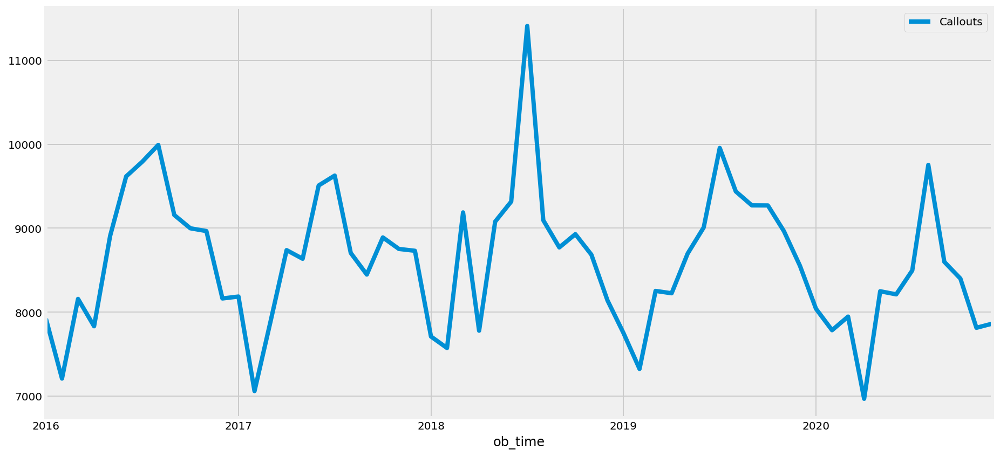

In [95]:
# Callouts by month
plt.figure(figsize=(14, 7))
groupedts1.callouts.resample('M').sum().plot(label='Callouts', legend=True);

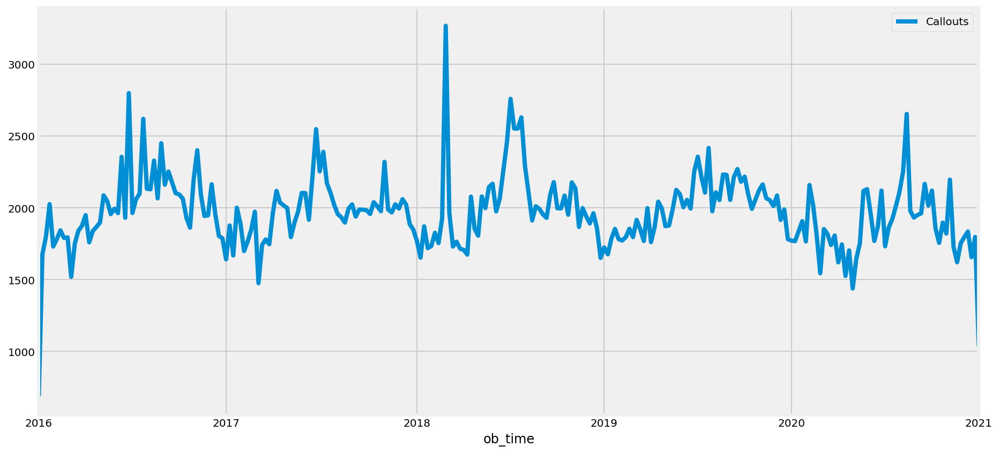

In [96]:
# Callouts by week (Showing variability with annual seasonality)
# 2018 spikes explained by cold weather/snow in Feb and heatwave (heathland fire) in July.
plt.figure(figsize=(14, 7))
groupedts1.callouts.resample('W').sum().plot(label='Callouts', legend=True);

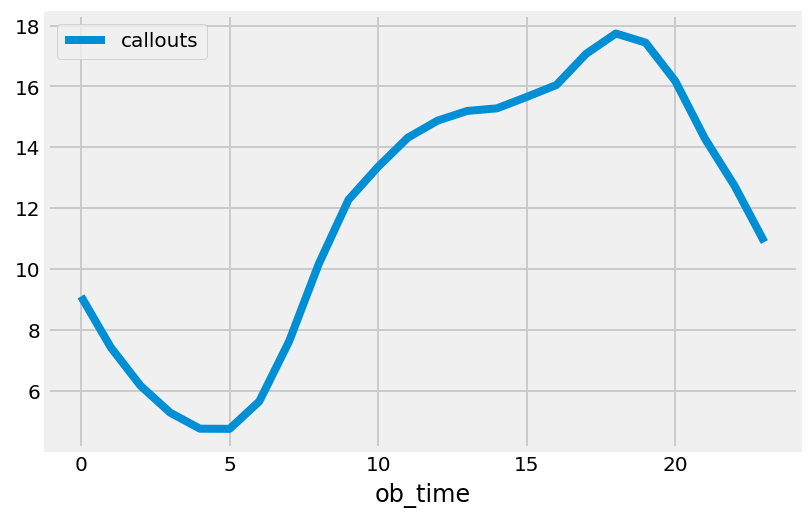

In [97]:
# Plot showing hour of day means for calls - there's some daily seasonality apparent.
groupedts1.groupby(groupedts1.index.hour).agg({'callouts':'mean'}).plot();

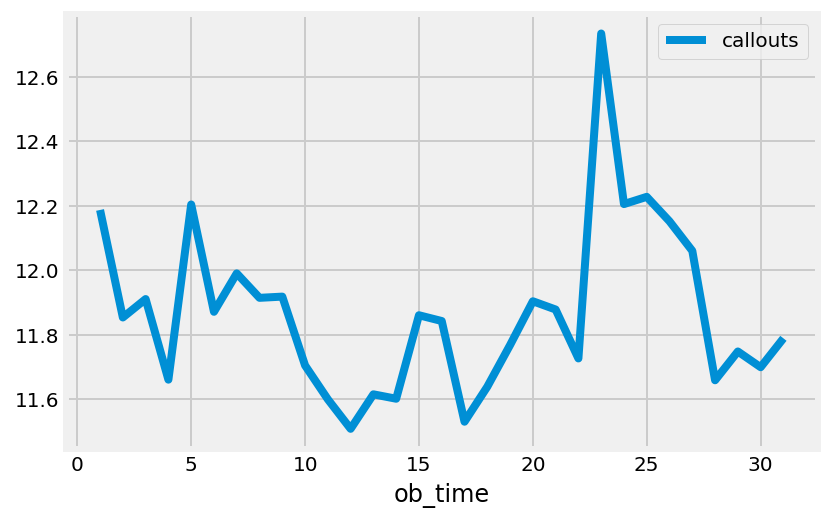

In [98]:
# Seasonality check over the month - none apparent
groupedts1.groupby(groupedts1.index.day).agg({'callouts':'mean'}).plot();

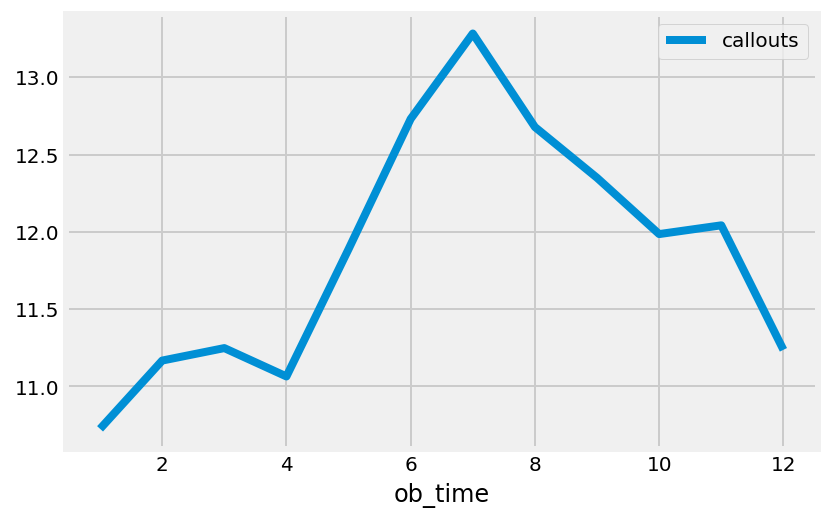

In [99]:
# Seasonality check - annual seasonality apparent.
groupedts1.groupby(groupedts1.index.month).agg({'callouts':'mean'}).plot();

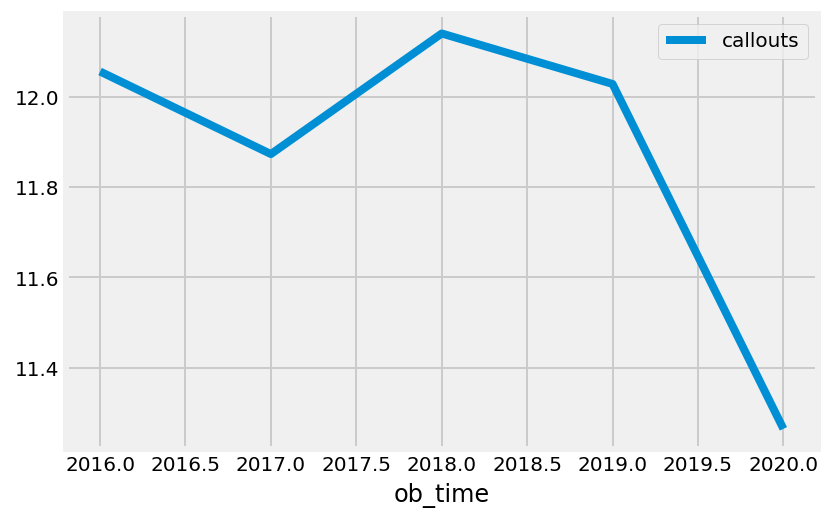

In [100]:
# Overall trend check (lockdown contributing to 2020 decline?)
groupedts1.groupby(groupedts1.index.year).agg({'callouts':'mean'}).plot();

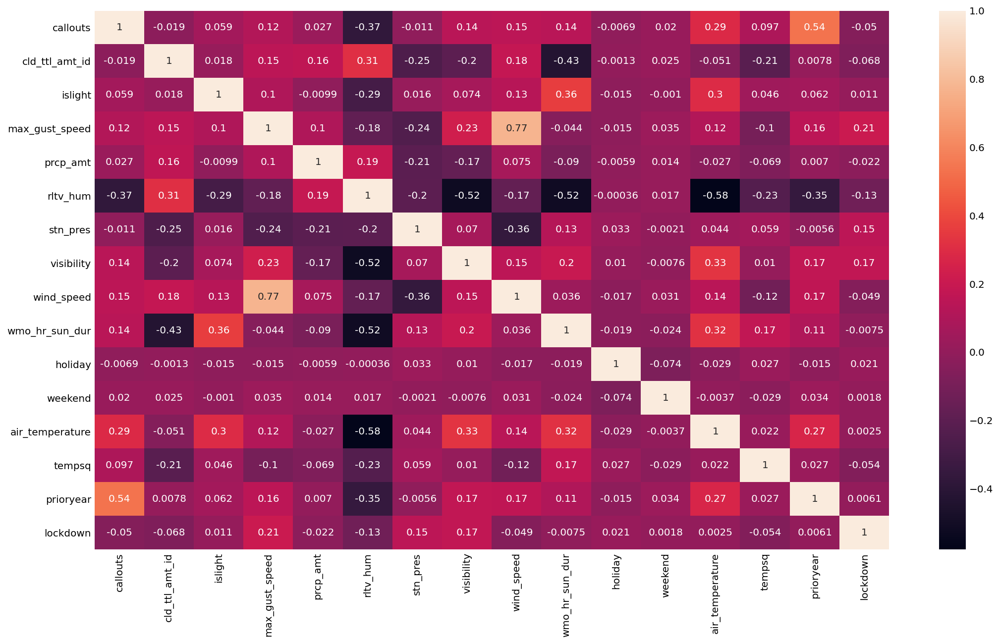

In [132]:
# Heatmap to investigate variable correlations (target and predictor)
f, ax = plt.subplots(figsize=(16, 10))
ax = sns.heatmap(groupedts1[[
 'callouts',
 'cld_ttl_amt_id',
 'islight',
 'max_gust_speed',
 'prcp_amt',
 'rltv_hum',
 'stn_pres',
 'visibility',
 'wind_dirc',
 'wind_speed',
 'wmo_hr_sun_dur',
 'holiday',
 'weekend',
 'air_temperature',
 'tempsq',
 'prioryear',
 'lockdown']].corr(), annot = True);

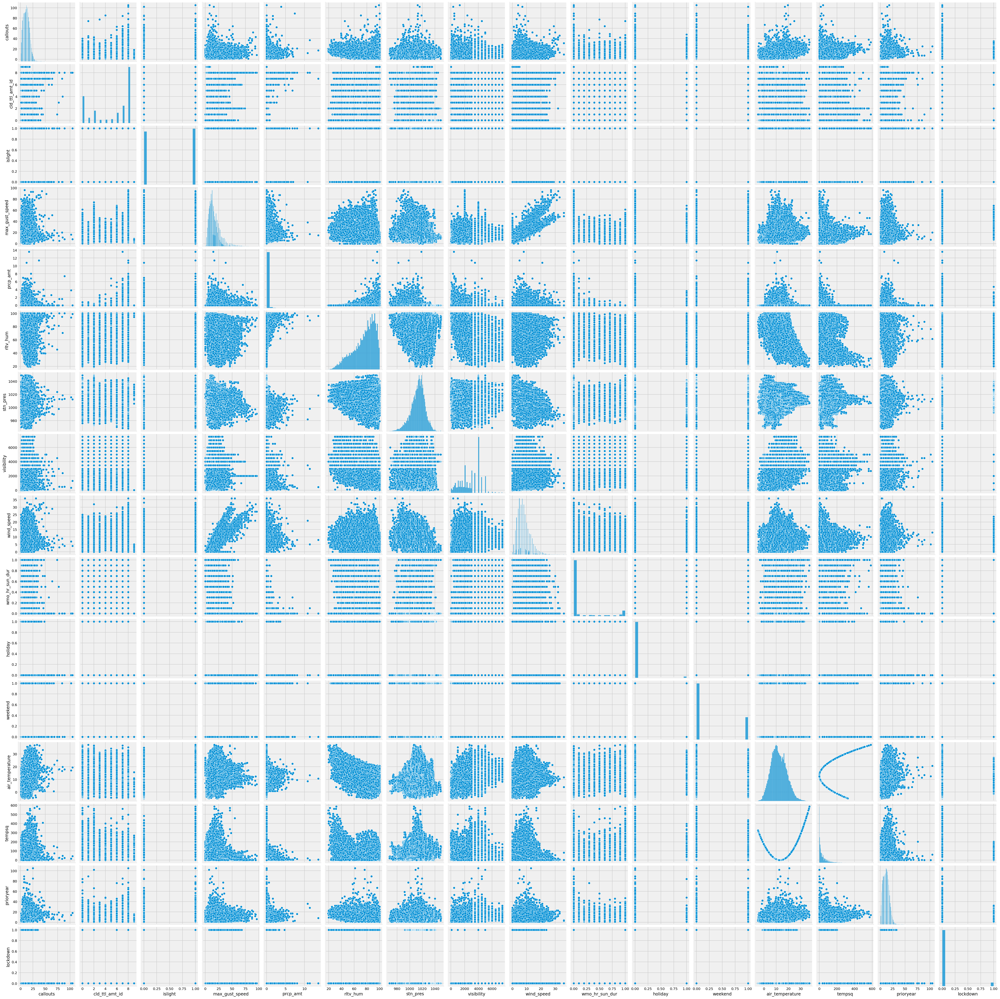

In [133]:
# Pairplot to investigate relations between pairs of variables (target and predictor)
sns.pairplot(groupedts1[[
 'callouts',
 'cld_ttl_amt_id',
 'islight',
 'max_gust_speed',
 'prcp_amt',
 'rltv_hum',
 'stn_pres',
 'visibility',
 'wind_dirc',
 'wind_speed',
 'wmo_hr_sun_dur',
 'holiday',
 'weekend',
 'air_temperature',
 'tempsq',
 'prioryear',
 'lockdown']]);

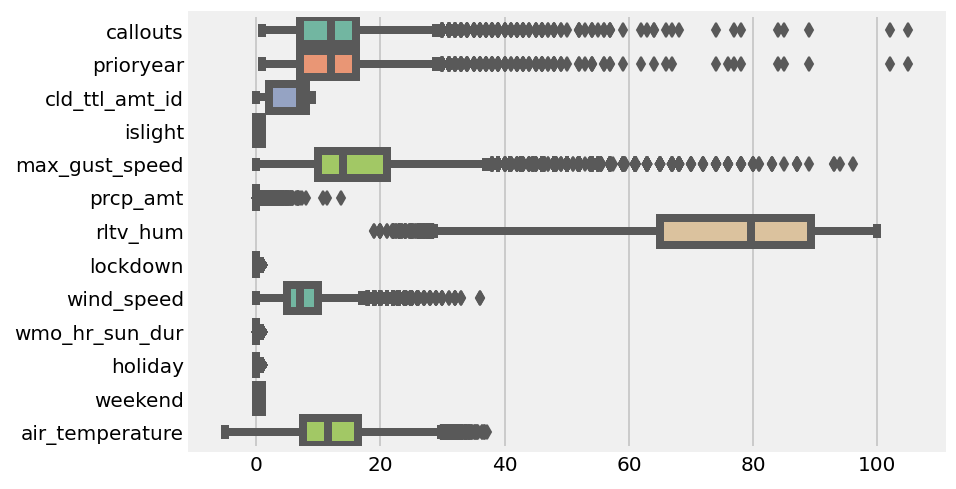

In [136]:
# Boxplots to see variable distribution (tempsq not included as derived from air temp). Boxcox considered for target.
ax = sns.boxplot(data=groupedts1[[
 'callouts',
 'prioryear',
 'cld_ttl_amt_id',
 'islight',
 'max_gust_speed',
 'prcp_amt',
 'rltv_hum', 
 'lockdown',
 'wind_speed',
 'wmo_hr_sun_dur',
 'holiday',
 'weekend',
 'air_temperature']], orient="h", palette="Set2")

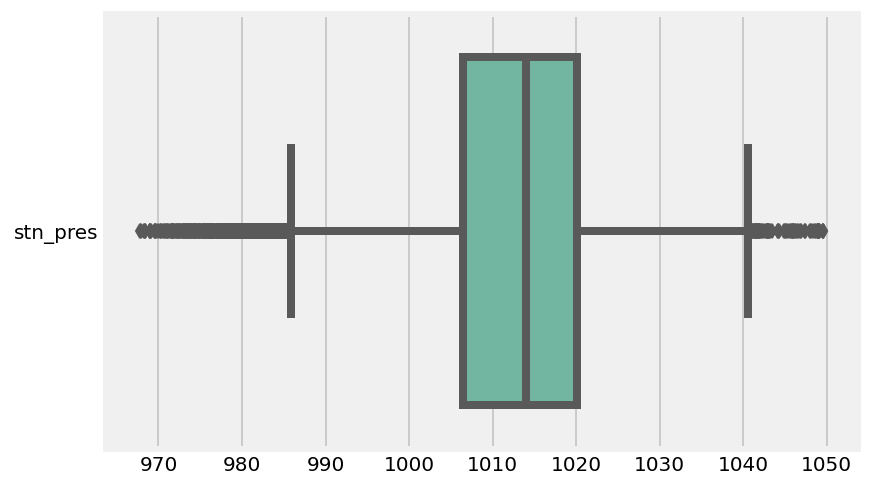

In [137]:
ax = sns.boxplot(data=groupedts1[[
 
 'stn_pres' 
 
 ]], orient="h", palette="Set2")

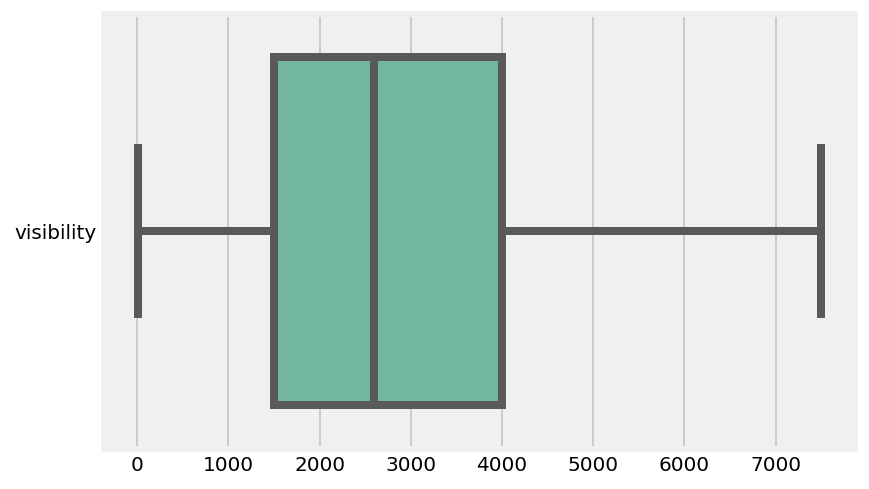

In [138]:
ax = sns.boxplot(data=groupedts1[[
 
 'visibility'
 
 
 ]], orient="h", palette="Set2")

## Classification EDA ##

In [ ]:
# Initially classifying type of callout according to suitable variables for the entire dataset

In [139]:
list(LFB.columns)

['DateOfCall',
 'CalYear',
 'HourOfCall',
 'IncidentGroup',
 'PropertyType',
 'SpecialServiceType',
 'IncidentStationGround',
 'ob_time',
 'holiday',
 'weekend',
 'lockdown',
 'air_temperature',
 'cld_ttl_amt_id',
 'islight',
 'max_gust_speed',
 'prcp_amt',
 'rltv_hum',
 'stn_pres',
 'visibility',
 'wind_speed',
 'wmo_hr_sun_dur',
 'tempsq',
 'wind_dirc']

In [142]:
LFBclass = LFB.drop(columns = ['DateOfCall',
 'CalYear',
  
 'SpecialServiceType',
 'IncidentStationGround'
 
])
LFBclass['ob_time'] = pd.to_datetime(LFBclass['ob_time'])
LFBclass.set_index('ob_time', inplace = True, drop=True)
LFBclass.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 518227 entries, 2017-01-01 10:00:00 to 2016-12-31 23:00:00
Data columns (total 18 columns):
 #   Column           Non-Null Count   Dtype   
---  ------           --------------   -----   
 0   HourOfCall       518227 non-null  int64   
 1   IncidentGroup    518227 non-null  object  
 2   PropertyType     518227 non-null  object  
 3   holiday          518227 non-null  int64   
 4   weekend          518227 non-null  int64   
 5   lockdown         518227 non-null  int64   
 6   air_temperature  518227 non-null  float64 
 7   cld_ttl_amt_id   518227 non-null  float64 
 8   islight          518227 non-null  int64   
 9   max_gust_speed   518227 non-null  float64 
 10  prcp_amt         518227 non-null  float64 
 11  rltv_hum         518227 non-null  float64 
 12  stn_pres         518227 non-null  float64 
 13  visibility       518227 non-null  float64 
 14  wind_speed       518227 non-null  float64 
 15  wmo_hr_sun_dur   518227 non-null  

In [144]:
LFBclass = LFBclass[LFBclass['IncidentGroup']!='0']

In [ ]:
LFBclass.info()

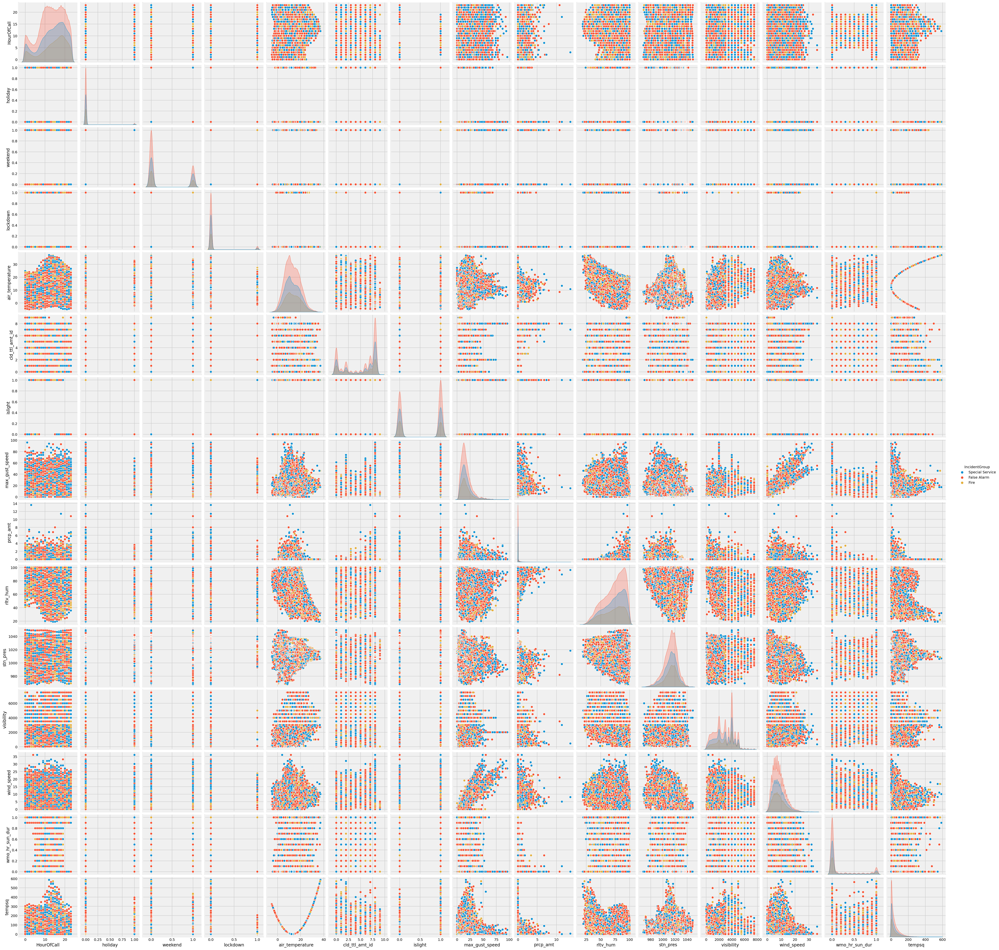

In [147]:
sns.pairplot(LFBclass, hue = 'IncidentGroup');

In [148]:
print('Unique Property Type Number ',LFBclass.PropertyType.nunique())

Unique Property Type Number  286


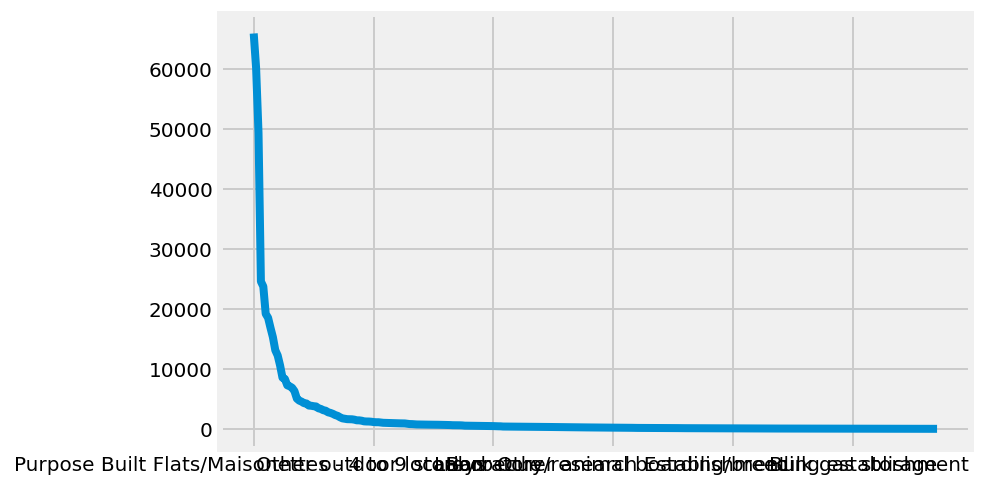

In [149]:
LFBclass.PropertyType.value_counts().plot();

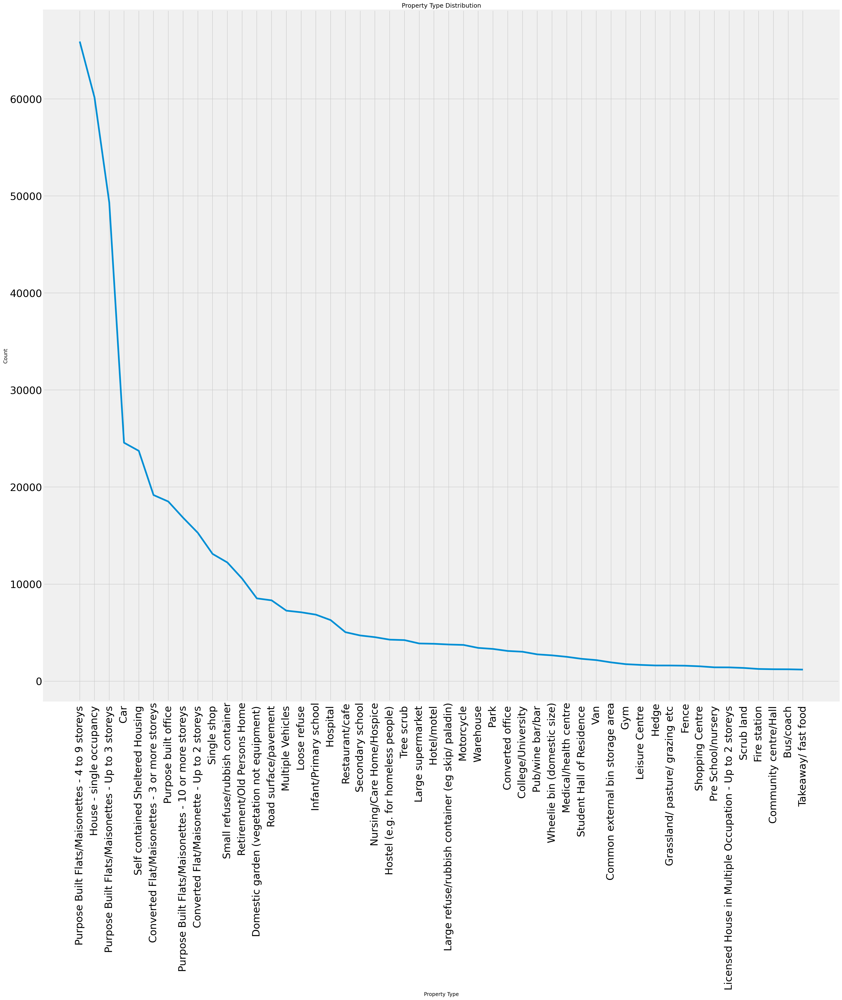

In [150]:
fig, ax = plt.subplots(figsize=(30, 30))
ax.plot(LFBclass.PropertyType.value_counts()[:50])

# Set title and labels for axes
ax.set(xlabel="Property Type",
       ylabel="Count",
       title="Property Type Distribution")
plt.xticks(rotation=90)
plt.rc('axes', titlesize=24)
matplotlib.rc('font', size=24)
ax.tick_params(axis = 'both', which = 'major', labelsize = 24)
ax.tick_params(axis = 'both', which = 'minor', labelsize = 16)
plt.show()

In [152]:
LFBclass.to_csv('Assets/LFBclass.csv')